In [3]:
import plotly.express as px
import numpy as np
from tqdm import tqdm
import pandas as pd

from scipy.spatial import distance_matrix

from matplotlib import pyplot as plt
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import os
from MPSE.MPSE import mview
from utils import *

%matplotlib inline

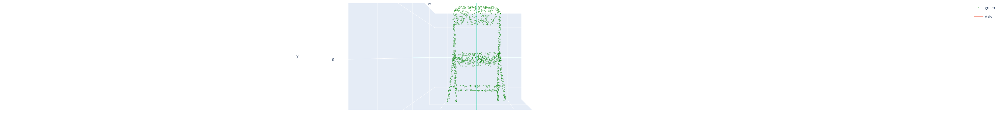

In [33]:
# points = get_dataset_points('toy_points', 1024)
points = get_dataset_points('ModelNet10:chair:0001', 1024)
plot_3D([points]).show()

In [37]:
labeled_perspectives = []
perspectives, projection_mats = get_randomized_all_persps(points, 8)
for perspective in perspectives:
    labeled_perspectives.append(give_ids(perspective))

proj = 'n_persp'
if proj == 'n_persp':
    labeled_perspectives = visible_in_n_persp(labeled_perspectives, 3)
elif proj == 'ray':
    labeled_perspectives = [
        ray_traceZ(p, n_raysX=80, n_raysY=80) for p in tqdm(labeled_perspectives)
    ]

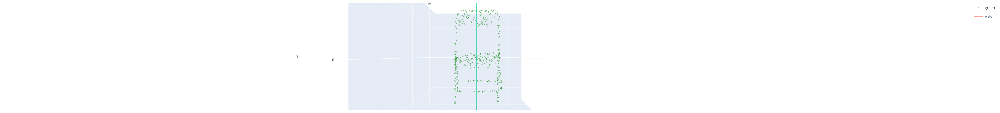

In [38]:
persp = remove_ids(labeled_perspectives[0])
plot_3D([add_col((persp))]).show()

8it [00:02,  3.82it/s]


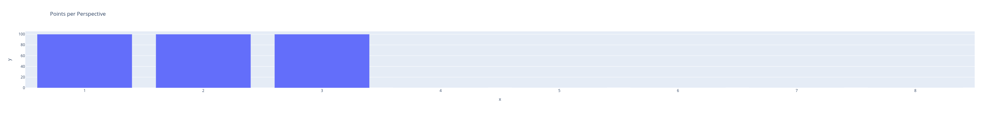

In [39]:
dist_mats, weights_mats = get_dist_weights(labeled_perspectives, len(points), ndim=2)

points_per_persp = np.array(show_points_least_persp(weights_mats))
points_per_persp = points_per_persp/points_per_persp.max() * 100

fig = px.bar(points_per_persp, x=range(1, len(points_per_persp)+1), y=points_per_persp, title="Points per Perspective")
fig.show()

mview.MPSE():
  data details:
    number of perspectives : 8
    number of samples : 1024
  visualization details:
    embedding dimension : 3
    image dimension : 2
    visualization type : mds
  setup visualization instance for perspective 1 :
    mview.MDS():
      data details:
        number of samples : 1024
        weighted : True
      embedding details:
        embedding dimension : 2
    initial embedding : random
    initial stress : 1.84e+01
  setup visualization instance for perspective 2 :
    mview.MDS():
      data details:
        number of samples : 1024
        weighted : True
      embedding details:
        embedding dimension : 2
    initial embedding : random
    initial stress : 1.85e+01
  setup visualization instance for perspective 3 :
    mview.MDS():
      data details:
        number of samples : 1024
        weighted : True
      embedding details:
        embedding dimension : 2
    initial embedding : random
    initial stress : 1.70e+01
  setup visuali

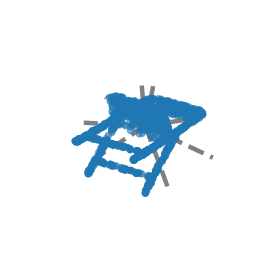

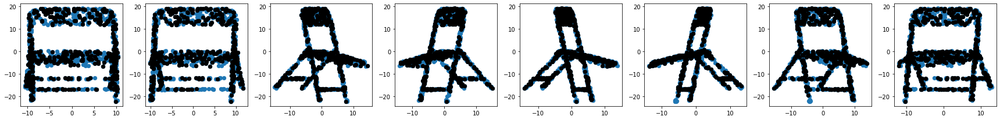

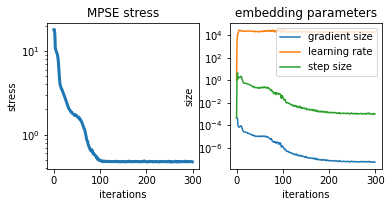

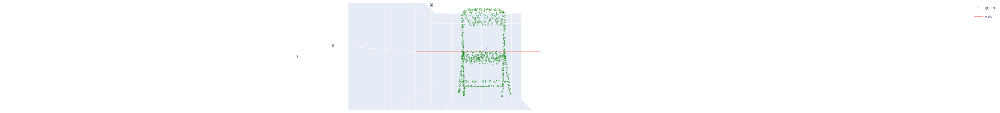

In [40]:
mv = mview.basic(dist_mats.copy(), #
                 batch_size = 128,
                 max_iter=300, min_grad=1e-10, min_cost=1e-9,
                 verbose=2, 
                 smart_initialization=False,
                 weights=weights_mats.copy(),
                 
                 # For fixed projections
                 fixed_projections = projection_mats,
                 
                 # For variable projections
#                  fixed_projections = None,
#                  initial_projections = 'cylinder'
                )

emb_plot = mv.plot_embedding()
imgs_plot = mv.plot_images()
comp_plot = mv.plot_computations()

plt.show()

embeddings = mv.X.copy()
plot_3D([embeddings]).show()

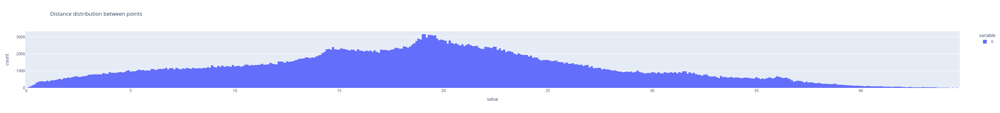

In [45]:
val = np.unique(np.triu(distance_matrix(embeddings, embeddings)))
val.sort()

px.histogram(val, title="Distance distribution between points")

In [46]:
def get_optimal_trans_mat(points_a, points_b, iterations=10000, dist_agg_fn=None, lr=0.001):
    if not dist_agg_fn:
        dist_agg_fn = lambda x: tf.math.sqrt(tf.reduce_mean(x*x))
    embeddings_tf = tf.convert_to_tensor(points_to_homo(points_a))
    gt_tf = tf.convert_to_tensor(points_to_homo(points_b))
    transform_mat = tf.Variable(np.identity(4), name='x', trainable=True, dtype=tf.float64)

    @tf.function
    def loss_fn():
        transformed = tf.transpose(tf.tensordot(transform_mat, tf.transpose(embeddings_tf), axes=1))
        dist = tf.norm(transformed - gt_tf, axis=1)
        return dist_agg_fn(dist)


    opt = tf.keras.optimizers.Adam()

    for i in tqdm(range(iterations)):
        opt.minimize(loss_fn, transform_mat)
    return transform_mat.numpy(), loss_fn().numpy()


100%|██████████████████████████████████████| 8000/8000 [00:09<00:00, 818.85it/s]

0.033977561636330506


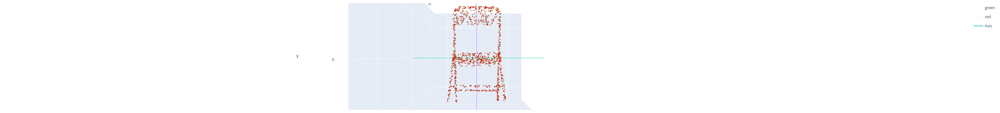

In [47]:
trans_mat, loss = get_optimal_trans_mat(embeddings, points, iterations=8000)
print(loss)
plot_3D([apply_transformation(embeddings, trans_mat), points], colors=['green', 'red'])

100%|███████████████████████████████████| 10000/10000 [00:01<00:00, 7351.62it/s]

0.03435239345194721


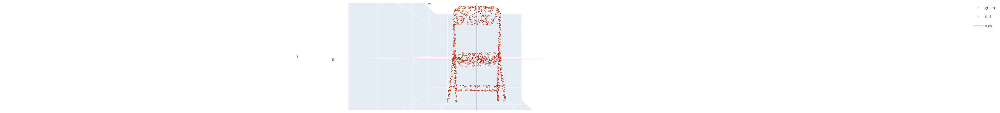

In [48]:
trans_mat, loss = get_4pointsample_transform_mat(embeddings, points)
print(loss)
plot_3D([apply_transformation(embeddings, trans_mat), points], colors=['green', 'red'])

In [12]:
a = np.array([
    [1, 2, 3],
    [3, 2, 1],
    [1, 0, 1]
])

b = np.array([
    [1, 0, 1],
    [2, 3, 1],
    [3, 2, 0]
])

np.dot(a, b)

array([[14, 12,  3],
       [10,  8,  5],
       [ 4,  2,  1]])

In [13]:
np.array([
    [14, 12, 3],
    [10, 8, 5],
    [4, 2, 1]
])

array([[14, 12,  3],
       [10,  8,  5],
       [ 4,  2,  1]])

In [23]:
def get_trans_mat_svd(points, gt):
    assert len(points) == len(gt), "The number of points must be equal"
    trans_mat = np.dot(
        np.dot(gt, points.T), 
        np.linalg.inv(
            np.dot(points, points.T)
        )
    )
    return np.linalg.svd(trans_mat)

In [25]:
U, Sigma, V = get_trans_mat_svd(embeddings, points)

In [29]:
U.shape, Sigma.shape, V.shape

((200, 200), (200,), (200, 200))

In [30]:
Sigma

array([9.35015679e+02, 2.39040059e+02, 2.23850165e+02, 2.17563046e+02,
       1.87273214e+02, 1.80110725e+02, 1.67279858e+02, 1.66305660e+02,
       1.62619636e+02, 1.53995796e+02, 1.50784839e+02, 1.42655628e+02,
       1.42244093e+02, 1.39042844e+02, 1.32516357e+02, 1.30686752e+02,
       1.29710942e+02, 1.27055011e+02, 1.22727305e+02, 1.19964768e+02,
       1.16606784e+02, 1.14174313e+02, 1.13651440e+02, 1.11333214e+02,
       1.06594542e+02, 1.05115617e+02, 1.03179822e+02, 1.01155801e+02,
       1.00044513e+02, 9.74017167e+01, 9.47431624e+01, 9.42110586e+01,
       9.29559332e+01, 9.07264118e+01, 9.00979471e+01, 8.77818632e+01,
       8.64255403e+01, 8.51025986e+01, 8.30762911e+01, 8.14703822e+01,
       8.02453088e+01, 7.80848641e+01, 7.70280781e+01, 7.55137162e+01,
       7.47576549e+01, 7.39595067e+01, 7.05903932e+01, 6.99063630e+01,
       6.88339574e+01, 6.76506498e+01, 6.74120948e+01, 6.63909337e+01,
       6.48033198e+01, 6.38733986e+01, 6.26233591e+01, 6.16328101e+01,
      

In [14]:
# icp_trans_mat, loss = get_icp_trans_mat(apply_transformation(embeddings, trans_mat), points, d_th=0.4, max_iter=1000, max_change_ratio=0.000001)

# print("Loss", loss)

# plot_3D([
#         apply_transformation(
#             apply_transformation(embeddings, trans_mat), 
#             icp_trans_mat
#         ),
#         points
#     ], 
#     colors=['green', 'red']
# )